## Imports

In [340]:
import numpy as np
import cv2
from PIL import Image
import math
import matplotlib.pyplot as plt

## Reading the images and doing some preprocessing (image resizing, cropping, etc...)

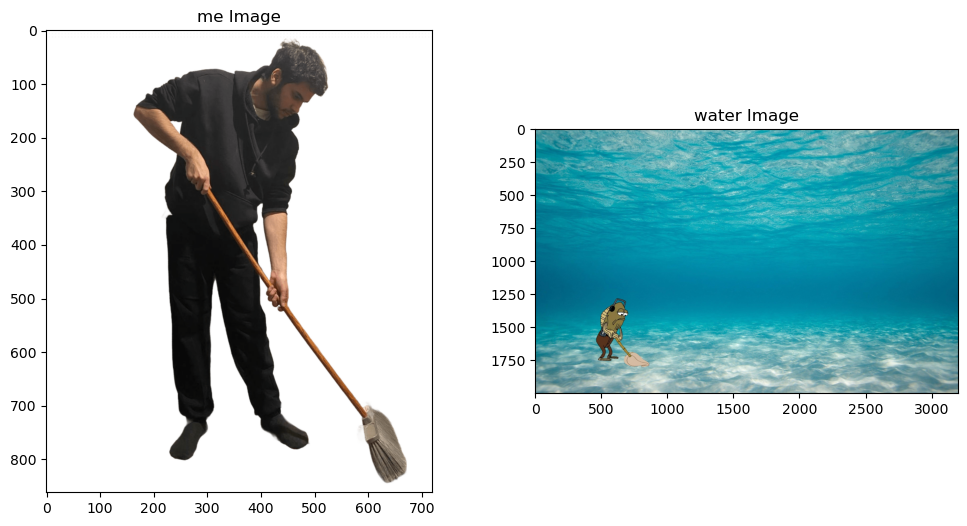

In [341]:
# Read the images and convert from BGR to RGB
water = cv2.imread("underwaterCleaning.jpg")
water = cv2.cvtColor(water, cv2.COLOR_BGR2RGB)

me = cv2.imread("meCleaning.png")
me = cv2.cvtColor(me, cv2.COLOR_BGR2RGB)

# Create a figure and subplots to display both images together
fig, axs = plt.subplots(1, 2, figsize=(12, 6))
# Display the me image
axs[0].imshow(me, cmap='gray')
axs[0].set_title('me Image')
# Display the sky image
axs[1].imshow(water, cmap='gray')
axs[1].set_title('water Image')
plt.show()

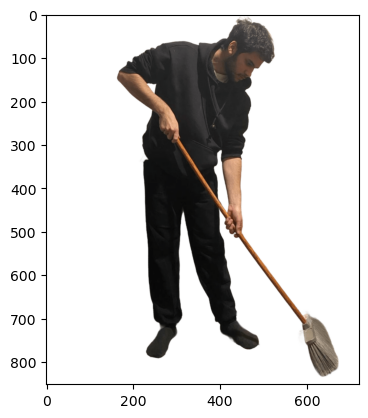

In [342]:
# Crop the image a bit.
me = me[10:, :]
plt.imshow(me)

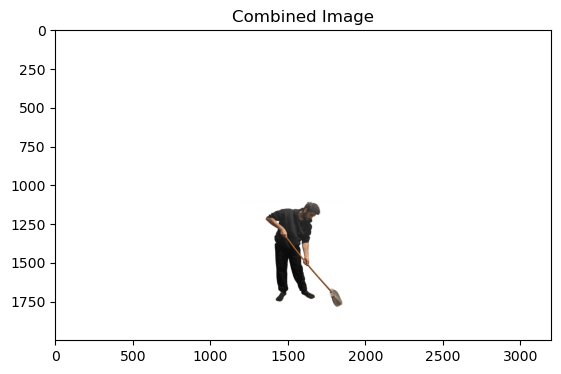

In [343]:
# first we will resize the me image, to be a smaller size so that it can realisticly fit in the water image next to the fish.

# Resize the me image to be 700 by 700
me_resized = cv2.resize(me, (700, 700))

# Create a white canvas of the same size as the water image
white_canvas = np.ones_like(water) * 255 # 255 because we want the background to be white

# Define the position to paste the resized me image onto the white canvas
position = (1200, 1100)

# Paste the resized me image onto the white canvas at the defined position
white_canvas[position[1]:position[1] + me_resized.shape[0], position[0]:position[0] + me_resized.shape[1]] = me_resized

# Display the combined image
me = white_canvas
plt.imshow(me)
plt.title('Combined Image')
plt.show()

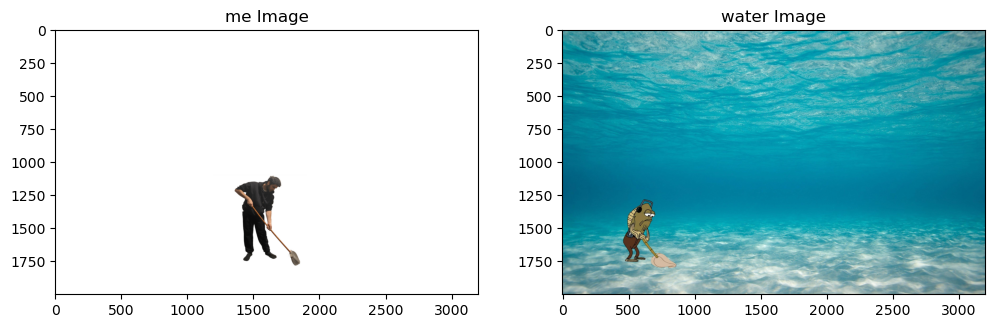

In [344]:
# Create a figure and subplots to display both images together
fig, axs = plt.subplots(1, 2, figsize=(12, 6))

# Display the me image
axs[0].imshow(me, cmap='gray')
axs[0].set_title('me Image')

# Display the sky image
axs[1].imshow(water, cmap='gray')
axs[1].set_title('water Image')
plt.show()

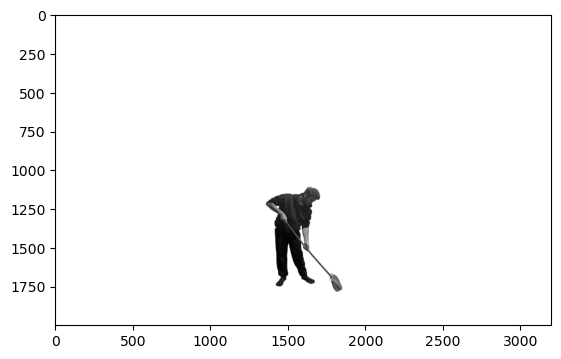

In [345]:
# First, convert the me image to grayscale.
# We will use that gray image to cut out the shape of the person from the me image and also from the sky image

me = cv2.cvtColor(me, cv2.COLOR_BGR2RGB)
me_gray = cv2.cvtColor(me, cv2.COLOR_RGB2GRAY)
plt.imshow(me_gray, cmap='gray')

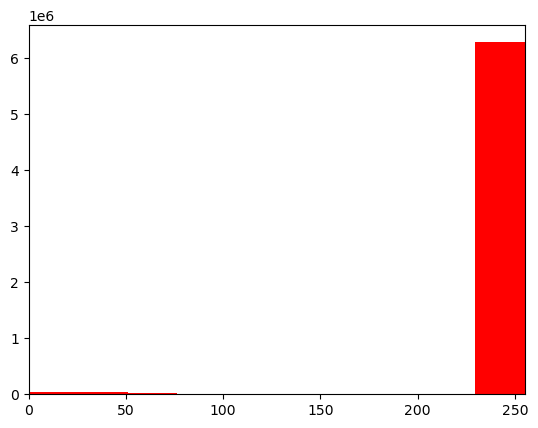

In [346]:
# We plot a histogram to see the distribution of the colors, so that we can define a threshold, to successfully cut the person
# in the me image

# We can make the bins smaller to see them more clearly

plt.hist(me_gray.flatten(), 10, [0,255], color='r')
plt.xlim([0, 255])
plt.show()

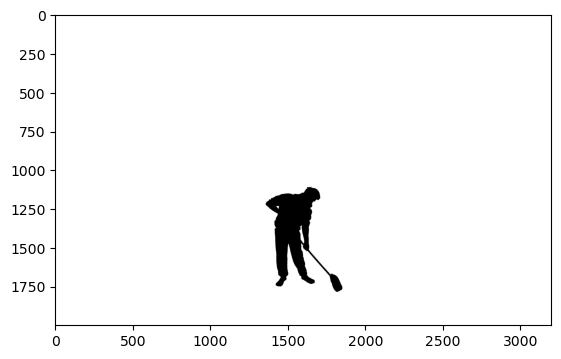

In [347]:
# Apply binary thresholding
# This, will create a mask of the "me" image, where any value above 200 (threshold),
# will have an intensity of [255] in the mask, and any value under 200, will have
# an intensity of 0

# So, the person in the image has dark clothes, which are all intensities is under 200,
# That's why the entire person has been turned black [0]

# So the mask will create a cut of the person's shape.
# The mask has only values of 0 or 255 (black or white).


threshold_value = 200
_, mask = cv2.threshold(me_gray, threshold_value, 255, cv2.THRESH_BINARY)
plt.imshow(mask, cmap='gray')

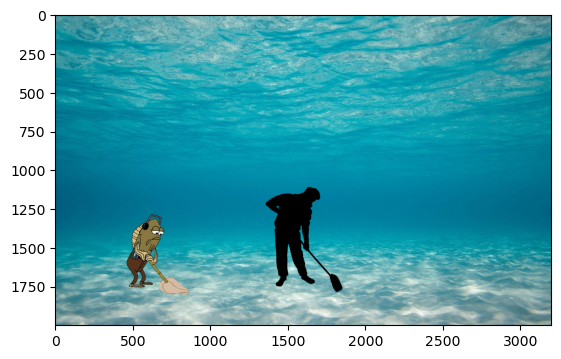

In [348]:
# We will use that created mask, to cut out the person's shape into the water image

# Bitwise and:
# 0 & 0 = 0
# 0 & 1 = 0
# 1 & 0 = 0
# 1 & 1 = 1

# So, when "anding" the mask, with the water image, we will turn the intensities in the water image
# to 0 because any value (from water image) anded with a 0 from the me image, will be 0
water = cv2.bitwise_and(water, water, mask= mask)
plt.imshow(water)

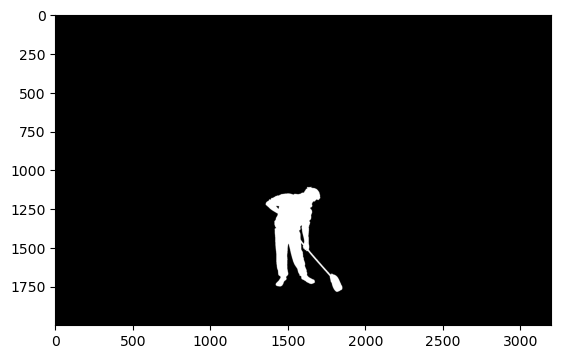

In [349]:
# Now, we will get the inverse of the previously created mask
mask_inv = cv2.bitwise_not(mask)
plt.imshow(mask_inv, cmap='gray')

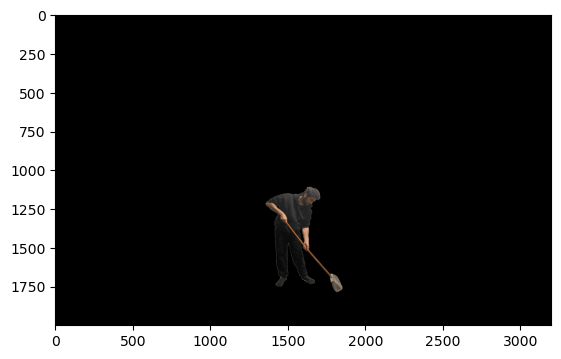

In [350]:
# Now, that we have the person's shape CUT OUT OF the water image,
# we want to get the person himself cut out from the original me image,
# so that we can add that cut out person into the water image, into the black cut-out part.

# Also create a mask around the edges of the person's shape, so that we can use that mask to apply Weighted Average Filter and Gaussian filter on those pixels (edges) only.
# The edges are the boundaries around the shape of the person in the "me" image.

me = cv2.bitwise_and(me, me, mask=mask_inv)
me = cv2.cvtColor(me, cv2.COLOR_BGR2RGB)
plt.imshow(me)

In [351]:
# Save the me image, to use later
original_me = me

---------------
Now, we want to smooth out the edges of the person's shape, so that when we add the person cutout onto the water background, the edges seem smooth and a bit blurred to appear realistic.

We can do tha by extracting exact edges and blurring them only, or we can apply the filter on the entire result image. At the end of this code file, we will find the code that applies the filter onto the entire image. But for now, we will apply the filters onto the exact edges.

Let's go through the process step by step and on one filter, before combining the entire process together and trying out different filters.

In [352]:
# We will work on a copy of the "me" image
person_cutout_rgb = me

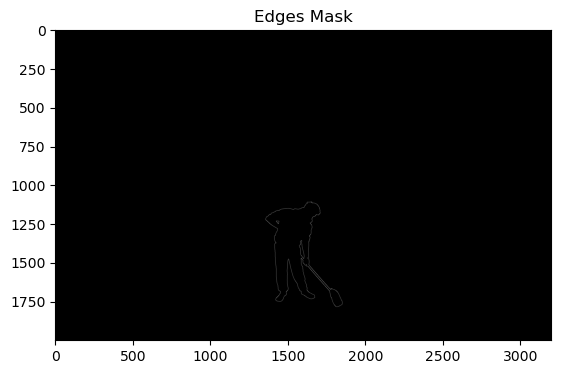

In [353]:
# We will create a mask that will extract ONLY the edges of the person's shape in the "me" image
# The parameters 30 and 100 represent Low Threshold and High Threshold values, respectively.
# These values control how strong the edge detection will be in the mask.
# I have tuned these parameters to get the best result.

edges_mask = cv2.Canny(mask_inv, 30, 100)
plt.imshow(edges_mask, cmap='gray')
plt.title('Edges Mask')
plt.show()

In [354]:
# then, we convert edges mask to 3 channels (RGB Image) because the next function (dilate) expects a 3 channel image.

edges_mask_rgb = cv2.cvtColor(edges_mask, cv2.COLOR_GRAY2RGB)

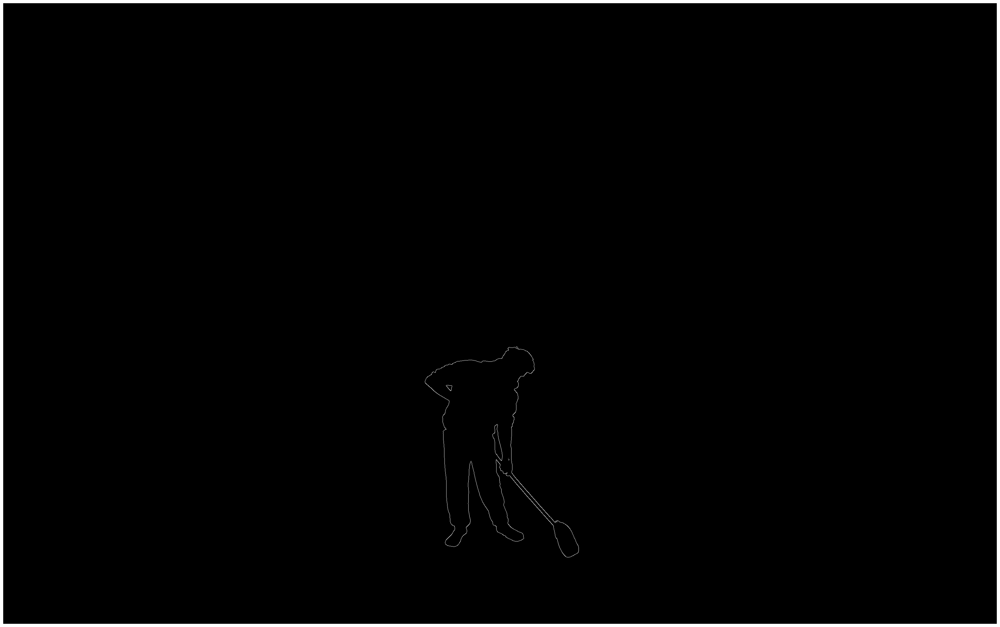

In [355]:
# Dilate the edges mask to include more pixels around the edges.
# We simply make the edge_mask thicker, so that we can apply the filters on a larger area around the edges.

# We apply this dilation operation "1" times using a "1x1" matrix of ones.
dilated_edges_mask = cv2.dilate(edges_mask_rgb, np.ones((1, 1), np.uint8), iterations=1)
plt.figure(figsize=(40, 40))
plt.axis('off')
plt.imshow(dilated_edges_mask, cmap='gray')

# We can see that the result mask is thicker than the one before!

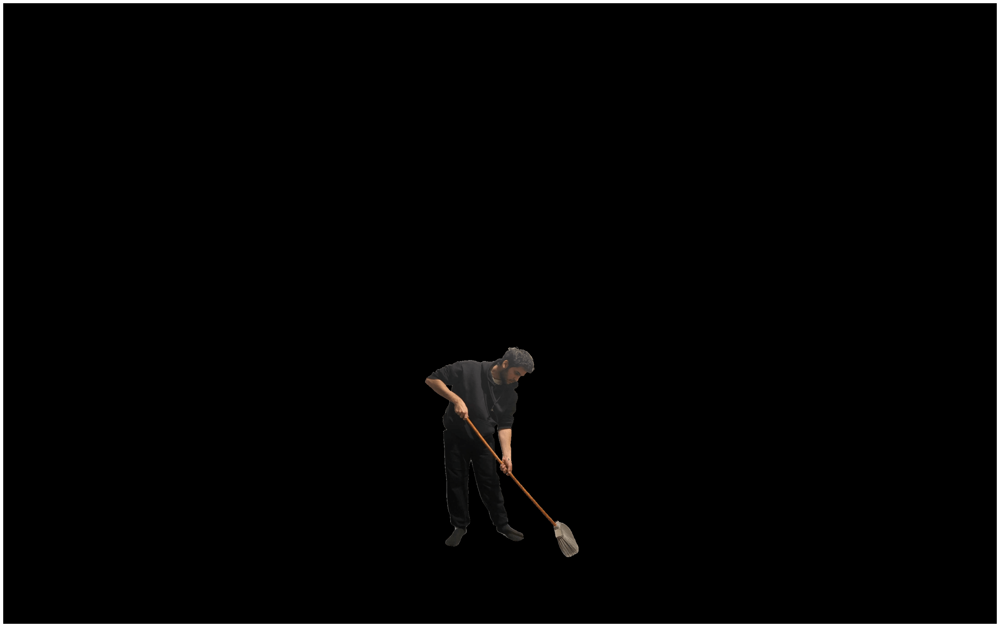

In [356]:
# Create a mask to isolate the pixels outside the dilated mask.
# We simply we get the all pixels of the person except for the ones that are in the dilated edge mask.

non_dilated_masked_area = cv2.bitwise_and(person_cutout_rgb, cv2.bitwise_not(dilated_edges_mask))
plt.figure(figsize=(40, 40))
plt.axis('off')
plt.imshow(non_dilated_masked_area)

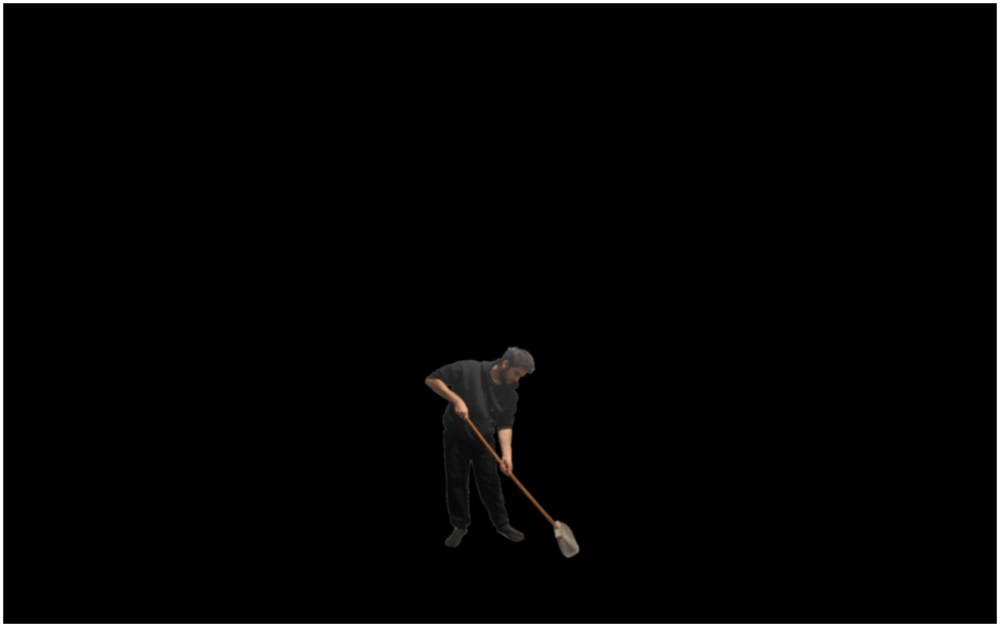

In [357]:
# Blur only the person cut out image using a Filter.
# In this case for example Gaussian Filter.
blurred_image = cv2.GaussianBlur(person_cutout_rgb, (15, 15), 0)
plt.figure(figsize=(40, 40))
plt.axis('off')
plt.imshow(blurred_image)

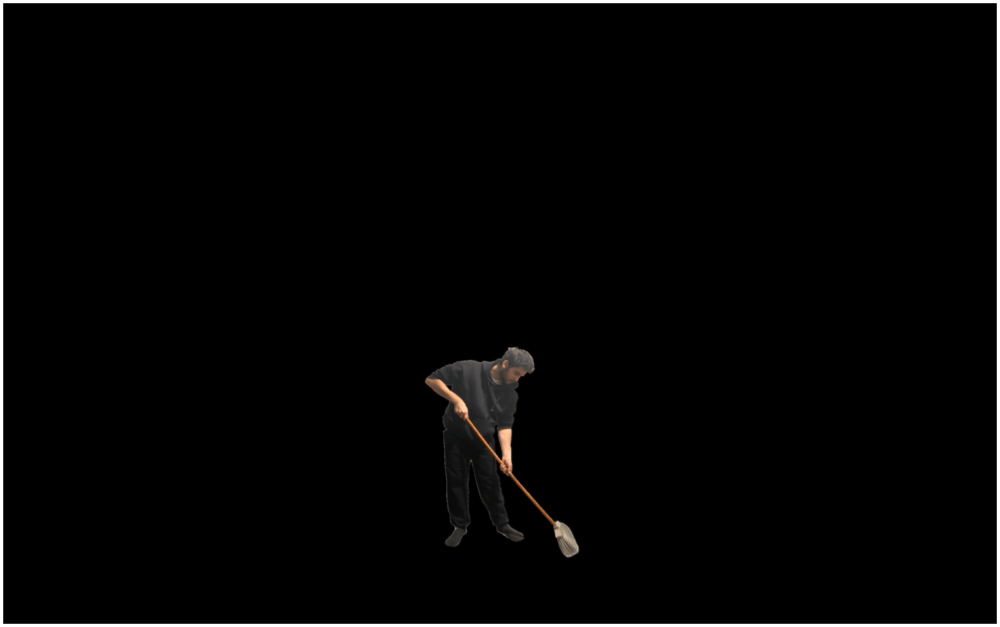

In [358]:
# Now, we combine the person_cutout (without the dilated area) with the blurred image (with the dilated area).
result_image = cv2.addWeighted(non_dilated_masked_area, 0.6, blurred_image, 0.6, 0)
plt.figure(figsize=(40, 40))
plt.axis('off')
plt.imshow(result_image)

# This results in the original cutout of the person, but with the edges smoothed out.

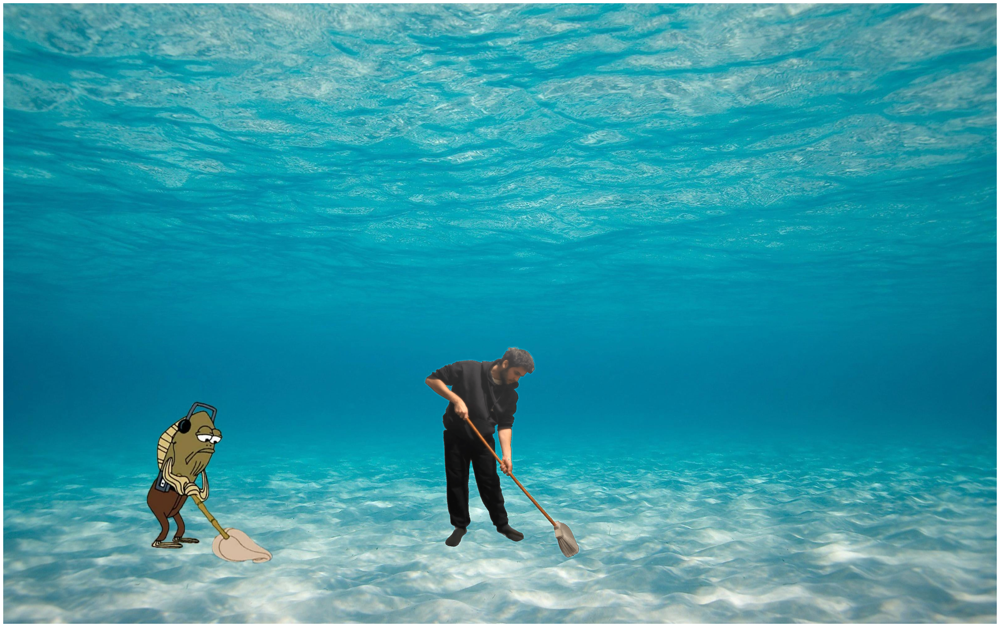

In [359]:
final_test_result_image = cv2.add(water, result_image)
plt.figure(figsize=(40, 40))
plt.axis('off')
plt.imshow(final_test_result_image)

--------------------
Now, let's put all these steps together and try out different filters, before adding the result smoothed image onto the water background!

In [360]:
# We will create a mask that will extract ONLY the edges of the person's shape in the "me" image
# The parameters 30 and 100 represent Low Threshold and High Threshold values, respectively.
# These values control how strong the edge detection will be in the mask.
# I have tuned these parameters to get the best result.edges_mask = cv2.Canny(mask_inv, 30, 100)
edges_mask = cv2.Canny(mask_inv, 30, 100)

In [361]:
# Then, we convert edges mask to 3 channels (RGB Image) because the next function (dilate) expects a 3 channel image.
edges_mask_rgb = cv2.cvtColor(edges_mask, cv2.COLOR_GRAY2RGB)

In [362]:
# Dilate the edges mask to include more pixels around the edges.
# We simply make the edge_mask thicker, so that we can apply the filters on a larger area around the edges.
# We apply this dilation operation "1" times using a "1x1" matrix of ones.
dilated_edges_mask = cv2.dilate(edges_mask_rgb, np.ones((1, 1), np.uint8), iterations=1)

In [363]:
# Create a mask to isolate the pixels outside the dilated mask.
# We simply we get the all pixels of the person except for the ones that are in the dilated edge mask.
non_dilated_masked_area = cv2.bitwise_and(person_cutout_rgb, cv2.bitwise_not(dilated_edges_mask))

In [364]:
# Blur only the person cut out image using the different filters and kernel sizes.:

# Gaussian Filter with kernel size 3
blurred_edges_gaussian_3 = cv2.GaussianBlur(person_cutout_rgb, (3, 3), 0)

# Weighted Average Filter using filter2D with kernel size 3
blurred_edges_average_3 = cv2.filter2D(person_cutout_rgb, -1, np.ones((3, 3), np.float32) / 9)

# Gaussian Filter with kernel size 5
blurred_edges_gaussian_5 = cv2.GaussianBlur(person_cutout_rgb, (5, 5), 0)

# Weighted Average Filter using filter2D with kernel size 5
blurred_edges_average_5 = cv2.filter2D(person_cutout_rgb, -1, np.ones((5, 5), np.float32) / 25)

# Gaussian Filter with kernel size 15
blurred_edges_gaussian_15 = cv2.GaussianBlur(person_cutout_rgb, (15, 15), 0)

# Weighted Average Filter using filter2D with kernel size 15
blurred_edges_average_15 = cv2.filter2D(person_cutout_rgb, -1, np.ones((15, 15), np.float32) / 225)

In [365]:
# Now, we combine the person_cutout (without the dilated area) with the blurred image (with the dilated area).
# But this time on all filters:

first_image_weight = 0.6
second_image_weight = 0.6

# Gaussian Filter with kernel size 3
result_image_gaussian_3 = cv2.addWeighted(non_dilated_masked_area, first_image_weight, blurred_edges_gaussian_3, second_image_weight, 0)

# Weighted Average Filter with kernel size 3
result_image_average_3 = cv2.addWeighted(non_dilated_masked_area, first_image_weight, blurred_edges_average_3, second_image_weight, 0)

# Gaussian Filter with kernel size 5
result_image_gaussian_5 = cv2.addWeighted(non_dilated_masked_area, first_image_weight, blurred_edges_gaussian_5, second_image_weight, 0)

# Weighted Average Filter with kernel size 5
result_image_average_5 = cv2.addWeighted(non_dilated_masked_area, first_image_weight, blurred_edges_average_5, second_image_weight, 0)

# Gaussian Filter with kernel size 15
result_image_gaussian_15 = cv2.addWeighted(non_dilated_masked_area, first_image_weight, blurred_edges_gaussian_15, second_image_weight, 0)

# Weighted Average Filter with kernel size 15
result_image_average_15 = cv2.addWeighted(non_dilated_masked_area, first_image_weight, blurred_edges_average_15, second_image_weight, 0)

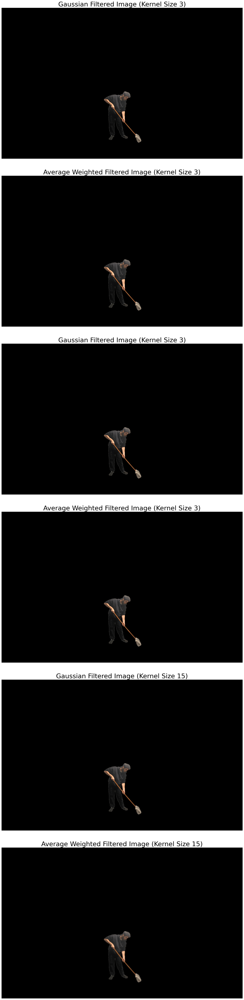

In [366]:
# Display the results
# Set the size of the plots
fig, axs = plt.subplots(6, 1, figsize=(36, 64))

axs[0].imshow(result_image_gaussian_3)
axs[0].set_title('Gaussian Filtered Image (Kernel Size 3)', fontsize=30)
axs[0].axis('off')

axs[1].imshow(result_image_average_3)
axs[1].set_title('Average Weighted Filtered Image (Kernel Size 3)', fontsize=30)
axs[1].axis('off')

axs[2].imshow(result_image_gaussian_5)
axs[2].set_title('Gaussian Filtered Image (Kernel Size 3)', fontsize=30)
axs[2].axis('off')

axs[3].imshow(result_image_average_5)
axs[3].set_title('Average Weighted Filtered Image (Kernel Size 3)', fontsize=30)
axs[3].axis('off')

axs[4].imshow(result_image_gaussian_15)
axs[4].set_title('Gaussian Filtered Image (Kernel Size 15)', fontsize=30)
axs[4].axis('off')

axs[5].imshow(result_image_average_15)
axs[5].set_title('Average Weighted Filtered Image (Kernel Size 15)', fontsize=30)
axs[5].axis('off')

# Adjust layout spacing.
plt.tight_layout(h_pad=5.0)

# Show the plots
plt.show()


In [367]:
# Now, we can simply add both images together.
# The images will be correctly added because when we add the values of one image to the black part of the other image,
# we add high values to the value 0, so the added values will stay the same

# These are our 6 result images:
# result_image_gaussian_3
# result_image_average_3
# result_image_gaussian_5
# result_image_average_5
# result_image_gaussian_15
# result_image_average_15


final_result_image_gaussian_3 = cv2.add(water, result_image_gaussian_3)
final_result_image_average_3 = cv2.add(water, result_image_average_3)
final_result_image_gaussian_5 = cv2.add(water, result_image_gaussian_5)
final_result_image_average_5 = cv2.add(water, result_image_average_5)
final_result_image_gaussian_15 = cv2.add(water, result_image_gaussian_15)
final_result_image_average_15 = cv2.add(water, result_image_average_15)

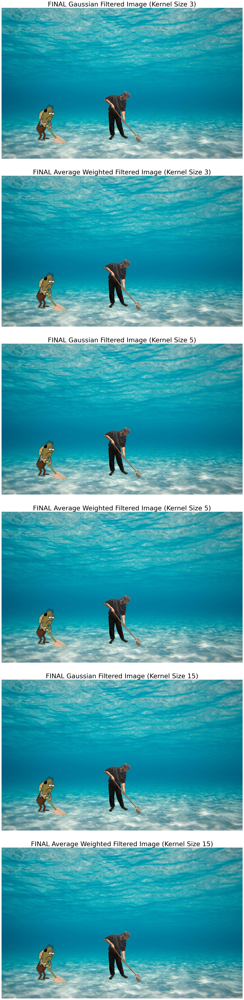

In [368]:
# Display the results
# Set the size of the plots
fig, axs = plt.subplots(6, 1, figsize=(36, 64))

axs[0].imshow(final_result_image_gaussian_3)
axs[0].set_title('FINAL Gaussian Filtered Image (Kernel Size 3)', fontsize=30)
axs[0].axis('off')

axs[1].imshow(final_result_image_average_3)
axs[1].set_title('FINAL Average Weighted Filtered Image (Kernel Size 3)', fontsize=30)
axs[1].axis('off')

axs[2].imshow(final_result_image_gaussian_5)
axs[2].set_title('FINAL Gaussian Filtered Image (Kernel Size 5)', fontsize=30)
axs[2].axis('off')

axs[3].imshow(final_result_image_average_5)
axs[3].set_title('FINAL Average Weighted Filtered Image (Kernel Size 5)', fontsize=30)
axs[3].axis('off')

axs[4].imshow(final_result_image_gaussian_15)
axs[4].set_title('FINAL Gaussian Filtered Image (Kernel Size 15)', fontsize=30)
axs[4].axis('off')

axs[5].imshow(final_result_image_average_15)
axs[5].set_title('FINAL Average Weighted Filtered Image (Kernel Size 15)', fontsize=30)
axs[5].axis('off')

# Adjust layout spacing.
plt.tight_layout(h_pad=5.0)

# Show the plots
plt.show()


---------
Here, we apply the filters onto the entire result image, instead of onto the edges only!

We will use a copy of the "me" image, before it was blurred.
It is the original cutout "me" image.

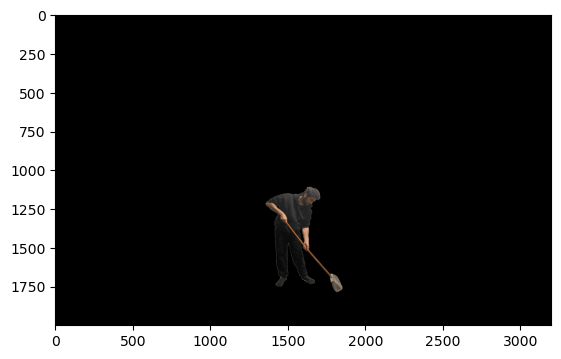

In [369]:
# Display the original "me" image.
plt.imshow(original_me)

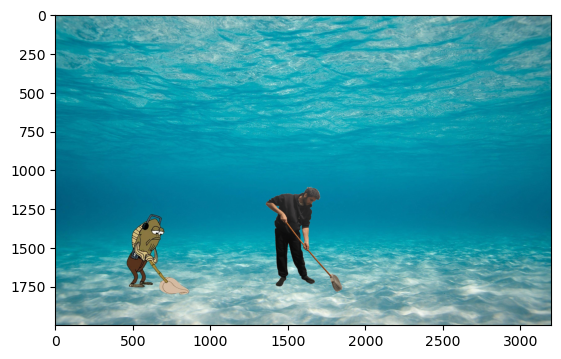

In [370]:
# Now, we can simply add both images together.
# The images will be correctly added because when we add the values of one image to the black part of the other image,
# we add high values to the value 0, so the added values will stay the same

original_result = cv2.add(water, original_me)
plt.imshow(original_result)

In [371]:
# Applying the filters
# We can increase kernel size here for more blur.



# Weighted Average Filter with kernel size = 5
kernel_5_size_wavg = 5  # We can increase kernel size for more blur
kernel_5_wavg = np.ones((kernel_5_size_wavg, kernel_5_size_wavg), np.float32) / (kernel_5_size_wavg * kernel_5_size_wavg)
result_5_wavg = cv2.filter2D(original_result, -1, kernel_5_wavg)

# Gaussian Filter with kernel size = 5
kernel_5_size_gaussian = 5
result_5_gaussian = cv2.GaussianBlur(original_result, (kernel_5_size_gaussian, kernel_5_size_gaussian), 0)

# Alpha blending with kernel size = 5
alpha = 0.7
result_5_alpha = cv2.addWeighted(original_result, alpha, result_5_gaussian, 1 - alpha, 0)



# Weighted Average Filter with kernel size = 3
kernel_size_wavg = 3
kernel_3_wavg = np.ones((kernel_size_wavg, kernel_size_wavg), np.float32) / (kernel_size_wavg * kernel_size_wavg)
result_3_wavg = cv2.filter2D(original_result, -1, kernel_3_wavg)

# Gaussian Filter with kernel size = 3
kernel_3_size_gaussian = 3
result_3_gaussian = cv2.GaussianBlur(original_result, (kernel_3_size_gaussian, kernel_3_size_gaussian), 0)

# Alpha blending with kernel size = 3
alpha = 0.7
result_3_alpha = cv2.addWeighted(original_result, alpha, result_3_gaussian, 1 - alpha, 0)

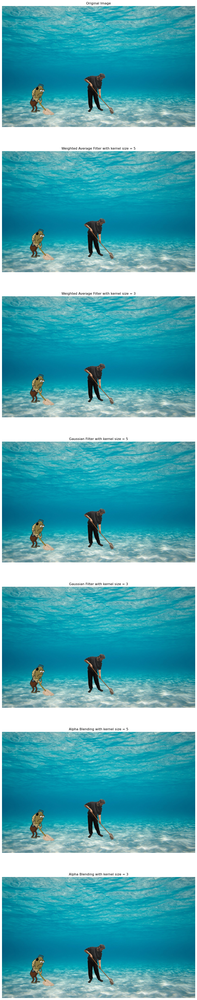

In [372]:
# Display the result images using the different filters
fig, axs = plt.subplots(7, 1, figsize=(32, 64))

axs[0].imshow(original_result)
axs[0].set_title('Original Image')
axs[0].axis('off')



axs[1].imshow(result_5_wavg)
axs[1].set_title('Weighted Average Filter with kernel size = 5')
axs[1].axis('off')

axs[2].imshow(result_3_wavg)
axs[2].set_title('Weighted Average Filter with kernel size = 3')
axs[2].axis('off')



axs[3].imshow(result_5_gaussian)
axs[3].set_title('Gaussian Filter with kernel size = 5')
axs[3].axis('off')

axs[4].imshow(result_3_gaussian)
axs[4].set_title('Gaussian Filter with kernel size = 3')
axs[4].axis('off')



axs[5].imshow(result_5_alpha)
axs[5].set_title('Alpha Blending with kernel size = 5')
axs[5].axis('off')

axs[6].imshow(result_3_alpha)
axs[6].set_title('Alpha Blending with kernel size = 3')
axs[6].axis('off')

plt.show()


# The results show that the kernel size = 3 achieves a higher smoothing and bluuring in the egdes of the image